# <div style="text-align: center; background-color:#b2182b; font-family:newtimeroman; color: white; padding: 14px; line-height: 1;border-radius:20px">Regression with a Tabular Gemstone Price Dataset</div>

<!-- marker_color = ['#67001f','#b2182b','#d6604d','#f4a582','#fddbc7','#d1e5f0','#92c5de','#4393c3','#2166ac'] -->

<p align="right">
    <img src="kaggle_score.jpg" width="100%">
</p>

## <div style="text-align: center;background-color:#d6604d; font-family:newtimeroman; color: white; padding: 14px; line-height: 1; border-radius:10px"> About Dataset</div>

The dataset for this competition (both train and test) was generated from a deep learning model trained on the [Gemstone Price Prediction dataset](https://www.kaggle.com/datasets/colearninglounge/gemstone-price-prediction). The goal is to predict <mark><b>price</b></mark> of the cubic zirconia.

There are <mark><b>9 independent</b></mark> variables (including id):

* <b>Carat</b>: a <mark><b>weight</b></mark> of the cubic zirconia. A metric “carat” is defined as 200 milligrams.
* <b>Cut</b>:  describes the <mark><b>cut quality</b></mark> of the cubic zirconia. Quality is increasing order Fair, Good, Very Good, Premium, Ideal.
* <b>Color</b>:  refers to the <mark><b>color</b></mark> of the cubic zirconia. With D being the best and J the worst.
* <b>Clarity</b>:  refers to the absence of the <mark><b>Inclusions</b></mark> and Blemishes. (In order from Best to Worst, FL = flawless, I3= level 3 inclusions) FL, IF, VVS1, VVS2, VS1, VS2, SI1, SI2, I1, I2, I3
* <b>Depth</b>:  the <mark><b>height</b></mark> of a cubic zirconia, measured from the Culet to the table, divided by its average Girdle Diameter.
* <b>Table</b>:  the <mark><b>width</b></mark> of the cubic zirconia's Table expressed as a Percentage of its Average Diameter.
* <b>X</b>:  <mark><b>Length</b></mark> of the cubic zirconia in mm.
* <b>Y</b>:  <mark><b>Width</b></mark> of the cubic zirconia in mm.
* <b>Z</b>:  <mark><b>Height</b></mark> of the cubic zirconia in mm.

Target Varibale:
* <b>Price</b>:  the Price of the cubic zirconia.

**Metrics**:
* RMSE

## <div style="text-align: center;background-color:#d6604d; font-family:newtimeroman; color: white; padding: 14px; line-height: 1; border-radius:10px">What was done in this notebook?</div>

* 1. Explore every features in the dataset; <br>

* 2. Feature Engineering; (<b>generation new features</b> and <b>encoding categorical features</b>)<br>

* 3. Regression Modeling to Predict Price;</b> (using <b>LGBMRegressor, XGBRegressor, CatBoostRegressor</b>)<br>

* 4. Hyperparameter Tuning;</b> (using <b>Optuna</b>)<br>
    
* 5. Utilizing <b><mark>stack technology</mark></b> leads to more accurate prediction results.

## <div style="text-align: center;background-color:#d6604d; font-family:newtimeroman; color: white; padding: 14px; line-height: 1; border-radius:10px"> Outlines </div>

<a id="top"></a>
 
   * [1. Import Necessary Libraries](#1)
   * [2. EDA](#2)
    - [2.1. Dataset Overview](#2.1)
    - [2.2. Univariate Analysis](#2.2)
        - [2.2.1. Explore Categorical Columns](#2.2.1)
        - [2.2.2. Explore Numeric Columns](#2.2.2)
    - [2.3. Bivariate Analysis](#2.3)
   * [3. Feature Enfineering](#3)
       - [3.1. Numerical Columns Processing](#3.1)  
       - [3.2. Categorical Feature Encoding](#3.2) 
   * [4. Modeling](#4)
       - [4.1. Base Model](#4.1)
       - [4.2. Model Fine-Tuning](#4.2)
           - [4.2.1. LGBMRegressor](#4.2.1)
           - [4.2.2. XGBRegressor](#4.2.2)
           - [4.2.3. CatBoostRegressor](#4.2.3)
   * [5. Ensemple Stacking](#5)

# <div style="text-align: center; background-color:#b2182b; font-family:newtimeroman; color: white; padding: 14px; line-height: 1;border-radius:20px">1. Import Necessary Libraries</div>

In [1]:
import pandas as pd
import numpy as np
import scipy.stats as ss
import itertools
from copy import deepcopy
import pickle
import warnings
warnings.filterwarnings('ignore')

# data visualization
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
from plotly.offline import download_plotlyjs, init_notebook_mode , plot
from plotly.graph_objs import *
init_notebook_mode()
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import plot
import missingno as msno

# Modeling
from sklearn.impute import SimpleImputer , KNNImputer
from sklearn.preprocessing import StandardScaler , MinMaxScaler
from lightgbm import LGBMRegressor
from xgboost import XGBRegressor
from catboost import CatBoost, CatBoostRegressor, CatBoostClassifier
from sklearn.ensemble import RandomForestRegressor , ExtraTreesRegressor
from sklearn.linear_model import LogisticRegression , LinearRegression , Ridge
from sklearn.model_selection import train_test_split , cross_val_score , KFold , StratifiedKFold , GridSearchCV
from sklearn.pipeline import make_pipeline
from sklearn.feature_selection import f_regression , SelectKBest , SelectPercentile
from sklearn.metrics import confusion_matrix , recall_score , precision_score , roc_curve , precision_recall_curve , auc  , mean_squared_error
from sklearn.decomposition import PCA , KernelPCA , TruncatedSVD
from tqdm import tqdm
from imblearn.over_sampling import SMOTE , BorderlineSMOTE , RandomOverSampler
from category_encoders import CountEncoder , LeaveOneOutEncoder , GLMMEncoder
from skopt import BayesSearchCV
from skopt.space import Real , Categorical , Integer
from optuna.integration import LightGBMPruningCallback
import optuna 
from optuna import Trial

# <div style="text-align: center; background-color:#b2182b; font-family:newtimeroman; color: white; padding: 14px; line-height: 1;border-radius:20px">2. EDA</div>

## <div style="text-align: left; background-color: #a33939; font-family:newtimeroman; color: white; padding: 14px; line-height: 1;border-radius:15px"> 2.1. Dataset Overview </div>

<h4> Read Dataframe, and explore data's <u>shape</u> & <u>distribution</u> of missing values & <u>info</u>:</h4>

There are a total of 10 columns, and 0 features have missing values.
There are a total of 9 columns, and 0 features have missing values.
There are a total of 10 columns, and 1 features have missing values.


Text(0.5, 1.0, 'Distribution of Missing Values(orignal Data)')

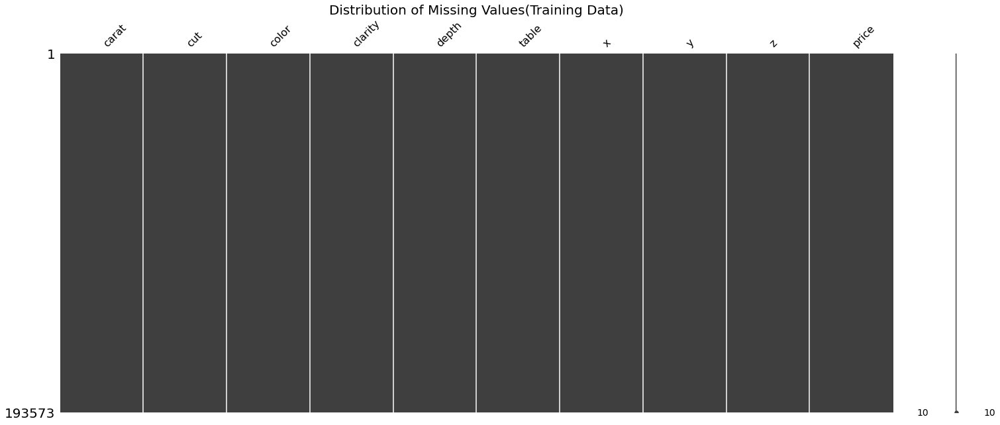

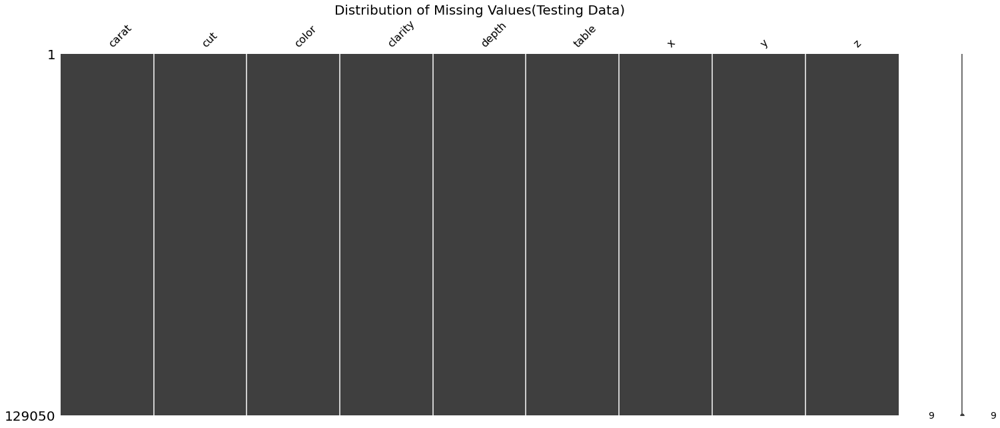

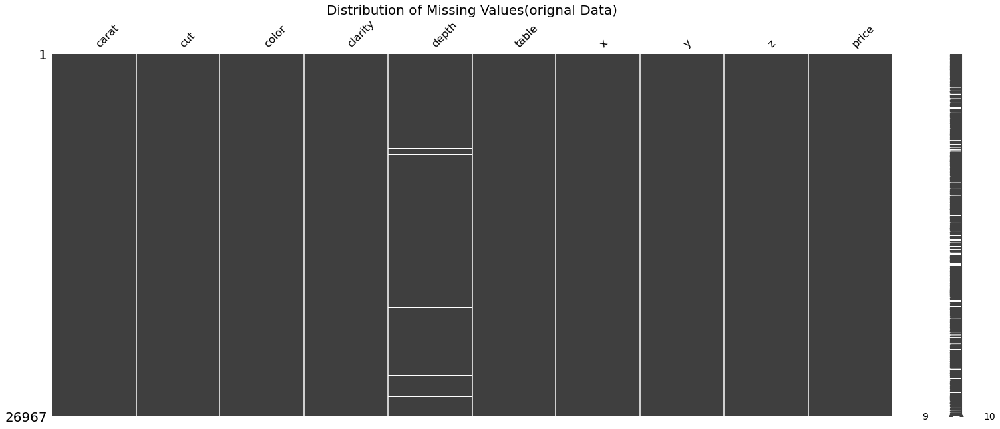

In [2]:
df_train = pd.read_csv('./train.csv' , index_col = 'id')
original = pd.read_csv('./cubic_zirconia.csv' , index_col = [0])
df_test = pd.read_csv('./test.csv' , index_col = 'id')

def missing_values_table(data):
    missing_value = data.isnull().sum()
    missing_value_percent = data.isnull().sum() / data.shape[0] * 100
    missing_value_table = pd.concat([missing_value , missing_value_percent] , axis = 1)
    missing_value_table = missing_value_table.rename(columns = {0 : 'Missing Values' , 1 : '% of Total Values'})
    missing_value_table.sort_values('% of Total Values' , ascending = False , inplace = True)
    print('There are a total of {} columns, and {} features have missing values.'.format(len(missing_value_table) , (missing_value_table['% of Total Values'] != 0).sum()))
    return missing_value_table.loc[missing_value_table['% of Total Values'] != 0]
missing_values_table(df_train)
missing_values_table(df_test)
missing_values_table(original)

msno.matrix(df_train).set_title('Distribution of Missing Values(Training Data)', fontsize = 20)
msno.matrix(df_test).set_title('Distribution of Missing Values(Testing Data)', fontsize = 20)
msno.matrix(original).set_title('Distribution of Missing Values(orignal Data)', fontsize = 20)

<h4>depth has missing values</h4>

In [3]:
original = original[~original['depth'].isna()]
df_train = df_train.rename(columns = {'price': 'label'})
original = original.rename(columns = {'price': 'label'})

In [4]:
# Delete features that have only one type.
feature_nunique = df_train.nunique()
feature_nunique_drop = feature_nunique[feature_nunique == 1]

def status(x) : 
    return pd.Series([x.count() , x.min() , x.idxmin() , x.quantile(.25) , x.median(), x.quantile(0.75) , 
                      x.mean() , x.max() , x.idxmax() , x.mad() , x.var(), x.std() , x.skew() , x.kurt()] , 
                      index=['count' , 'min' , 'min_index' , '25%' , '50%' , '75%' , 'mean' , 'max' , 'max_index' , 'mad' , 'var' , 'std' , 'skew' , 'kurt'])

object_features = []
for col in df_train.columns:
    if df_train[col].dtypes == 'object':
        object_features.append(col)
number_features = list(set(list(df_train.columns)).difference(set(object_features)))
number_features = [num_f for num_f in number_features if num_f != 'label']

number_describe = df_train[number_features].apply(status)
object_describe = df_train[object_features].describe()

In [5]:
number_describe.T.style.background_gradient(low = 0.2 , high = 0.5 , cmap = 'rocket_r')

,count,min,min_index,25%,50%,75%,mean,max,max_index,mad,var,std,skew,kurt
table,193573.000000,49.000000,27886.000000,56.000000,57.000000,58.000000,57.227675,79.000000,166514.000000,1.533263,3.681963,1.918844,0.619062,0.810180
carat,193573.000000,0.200000,1144.000000,0.400000,0.700000,1.030000,0.790688,3.500000,140193.000000,0.379665,0.214080,0.462688,0.995135,0.537398
y,193573.000000,0.000000,92703.000000,4.710000,5.720000,6.510000,5.720094,10.010000,47783.000000,0.942053,1.215139,1.102333,0.356758,-0.810668
x,193573.000000,0.000000,92703.000000,4.700000,5.700000,6.510000,5.715312,9.650000,140193.000000,0.947513,1.230818,1.109422,0.361050,-0.801006
z,193573.000000,0.000000,8750.000000,2.900000,3.530000,4.030000,3.534246,31.300000,167044.000000,0.588035,0.474614,0.688922,0.685671,12.818313
depth,193573.000000,52.100000,20056.000000,61.300000,61.900000,62.400000,61.820574,71.600000,90538.000000,0.794204,1.170084,1.081704,-0.276382,2.477041


In [6]:
object_describe.T

,count,unique,top,freq
cut,193573,5,Ideal,92454
color,193573,7,G,44391
clarity,193573,8,SI1,53272


## <div style="text-align: left; background-color: #a33939; font-family:newtimeroman; color: white; padding: 14px; line-height: 1;border-radius:15px"> 2.2. Univariate Analysis </div>

<h4> We got 9 columns: <mark>6 numeric</mark> columns & <mark>3 categorical</mark> columns.</h4><br>
<h4>Mainly two parts in the section: Analysis on <u>numeric columns; Analysis on </u><u>categorical columns</u>.</h4>

## <div style="text-align: left; background-color:#d6604d; font-family:newtimeroman; color: white; padding: 8px; line-height: 1;border-radius:5px"> 2.2.1. Explore Categorical Columns</div>

<h4>Categorical Columns in the dataset:</h4>

*  1. Cut
*  2. Color
*  3. Clarity

<h4> Explore categorical columns by plotting <mark>barplot</mark>.</h4>

In [7]:
def groupby_count(df , feature , mode):
    df_count = df.groupby(feature).apply(lambda x : len(x))
    df_count = pd.DataFrame(df_count)
    df_count[feature] = df_count.index
    df_count = df_count.rename({0 : 'count'} , axis = 1).reset_index(drop = True)
    df_count['mode'] = mode
    return df_count

def obj_feature_count(feature):
    df_train_count = groupby_count(df_train , feature , 'Training Data')
    df_test_count = groupby_count(df_test , feature , 'Testing Data')
    original_count = groupby_count(original , feature , 'Original Data')
    df_train_count['percentage'] = df_train_count['count']  / df_train_count['count'].sum()
    df_test_count['percentage'] = df_test_count['count']  / df_train_count['count'].sum()
    original_count['percentage'] = original_count['count']  / original_count['count'].sum()
    total = pd.concat([df_train_count , df_test_count , original_count] , axis = 0)

    fig = px.bar(x = total['mode'], 
                 y = total['percentage'] , 
                 text = np.round(total['percentage'] , 3)  ,
                 color = total[feature] ,
                 barmode = 'group', 
                 color_discrete_sequence = px.colors.sequential.RdBu,
                 title = '{} Percentage Bar Plot'.format(feature))

    fig.update_traces(marker = dict(line = dict(color = '#000000' , width = 2)))
    fig.update_layout(xaxis_title = feature,
                      yaxis_title = 'Percentage', 
                      font = dict(size=17 , family = 'Franklin Gothic') , 
                      template = 'plotly_dark') 
    fig.show()

for obj_f in object_features:
    obj_feature_count(obj_f)    

<h4>From above:</h4>

1. Most of the cubic zirconia stones in the dataset are colorless.<br>
2. The dataset predominantly consists of cubic zirconia stones with ideal and premium cuts.<br>
3. The dataset primarily consists of cubic zirconia stones with clarity grades of SI1 and VS2, indicating that the majority of the stones are of high quality.

## <div style="text-align: left; background-color:#d6604d; font-family:newtimeroman; color: white; padding: 8px; line-height: 1;border-radius:5px"> 2.2.2. Explore Numeric Columns</div>

<h4>Numeric Columns in the DataFrame:</h4>

* 1.X <br>
* 2.Y <br>
* 3.Z <br>
* 4.Carat <br>
* 5.table <br>

<h4> Explore numeric in the dataset by plotting <mark>distplot</mark>.</h4>

In [8]:
def num_feature_dist(feature):
    df_train_ = df_train.copy(deep = True)
    df_test_ = df_test.copy(deep = True)
    original_ = original.copy(deep = True)
    df_train_['mode'] = 'Train'
    df_test_['mode'] = 'Test'
    original_['mode'] = 'original'
    total = pd.concat([df_train_ , df_test_ , original_] , axis = 0)

    train_data = total.loc[total['mode'] == 'Train']
    test_data = total.loc[total['mode'] == 'Test']
    original_data = total.loc[total['mode'] == 'original']

    
    if feature == 'label':
        hist_data = [train_data[feature] , original_data[feature]]
        group_labels = ['Trianing Data' , 'Original Data']
        fig = ff.create_distplot(hist_data , group_labels , show_hist = False , show_rug = False , colors = ['#b2182b' , '#2166ac' , '#a7dbe8'])
        fig.update_layout(xaxis_title = feature,
                          title = 'price Distribution' ,
                          font = dict(size = 17 , family = 'Franklin Gothic') , 
                          template = 'plotly_dark')
    else:   
        hist_data = [train_data[feature] , test_data[feature] , original_data[feature]]
        group_labels = ['Trianing Data' , 'Testing Data' , 'Original Data']
        fig = ff.create_distplot(hist_data , group_labels , show_hist = False , show_rug = False , colors = ['#b2182b' , '#2166ac' , '#a7dbe8'])
        fig.update_layout(xaxis_title = feature,
                      title = '{} Distribution'.format(feature) ,
                      font = dict(size = 17 , family = 'Franklin Gothic') , 
                      template = 'plotly_dark') 
    fig.show()
    
for num_f in ['x' , 'y' , 'z' , 'carat' , 'table' , 'label']:
    num_feature_dist(num_f)     

<h4>From above:</h4>

1. Most of the cubic zirconia stones in the dataset have a weight of less than 1 carat.

2. The dataset primarily consists of cubic zirconia stones with table percentages predominantly ranging from 55% to 60%, with 56% and 57% being the most frequent values.

3. Since all distributions are quite similar, it's reasonable to concatenate the training data and related training data before training.

In [9]:
df_train = pd.concat([df_train , original]).drop_duplicates()
label = df_train['label']
df_train = df_train.drop(['label'] , axis = 1)
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 219578 entries, 0 to 26967
Data columns (total 9 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   carat    219578 non-null  float64
 1   cut      219578 non-null  object 
 2   color    219578 non-null  object 
 3   clarity  219578 non-null  object 
 4   depth    219578 non-null  float64
 5   table    219578 non-null  float64
 6   x        219578 non-null  float64
 7   y        219578 non-null  float64
 8   z        219578 non-null  float64
dtypes: float64(6), object(3)
memory usage: 16.8+ MB


## <div style="text-align: left; background-color: #a33939; font-family:newtimeroman; color: white; padding: 14px; line-height: 1;border-radius:15px"> 2.3. Bivariate Analysis </div>

<h4> Analysis on the relationship of Price between Cut, Clor and Clarity by plotting <mark>boxtplot.</mark> </h4>

In [10]:
df_train_label = pd.concat([df_train , pd.DataFrame(label)] , axis = 1)
for obj_f in object_features:    
    fig = px.box(df_train_label , 
                 x = obj_f , 
                 y = 'label' , 
                 color_discrete_sequence = px.colors.sequential.YlOrRd , 
                 title = '{} vs label (box plot)'.format(obj_f), 
                 color = obj_f)
    
    fig.update_layout(yaxis_title = 'Price',
                      font = dict(size = 17 , family = 'Franklin Gothic') , 
                      template = 'plotly_dark') 
    
    fig.show()

<h4>We can try using the median of the "Price" grouped by each categorical feature as the basis for encoding categorical features.</h4>

# <div style="text-align: center; background-color:#b2182b; font-family:newtimeroman; color: white; padding: 14px; line-height: 1;border-radius:20px">3. Feature Enfineering</div>

## <div style="text-align: left; background-color: #a33939; font-family:newtimeroman; color: white; padding: 14px; line-height: 1;border-radius:15px"> 3.1. Numerical Columns Processing (Generate New Feature) </div>

In [11]:
df_train['test'] = False
df_test['test'] = True
df = pd.concat([df_train , df_test] , axis = 0)
df['y_carat'] = df['y'] * df['carat']
df['x_carat'] = df['x'] * df['carat']
df['area'] = df['y'] * df['x']
df['area_carat'] = df['carat'] / (df['area'] + 1e-6)
df['volume'] = df['x'] * df['y'] * df['z']
df['density'] = df['carat'] / (df['volume'] + 1e-6)
df['depth_per_volume'] = df['depth'] / (df['volume'] + 1e-6)
df['depth_per_density'] = df['depth'] / (df['density'] + 1e-6)
df['depth_per_table'] = df['depth'] / (df['table'] + 1e-6)

df_train = df.loc[~df['test']].drop('test' , axis = 1)
df_test = df.loc[df['test']].drop('test' , axis = 1)

## <div style="text-align: left; background-color: #a33939; font-family:newtimeroman; color: white; padding: 14px; line-height: 1;border-radius:15px"> 3.2. Categorical Feature Encoding </div>

Text(0.5, 1.0, 'Correlation Plot')

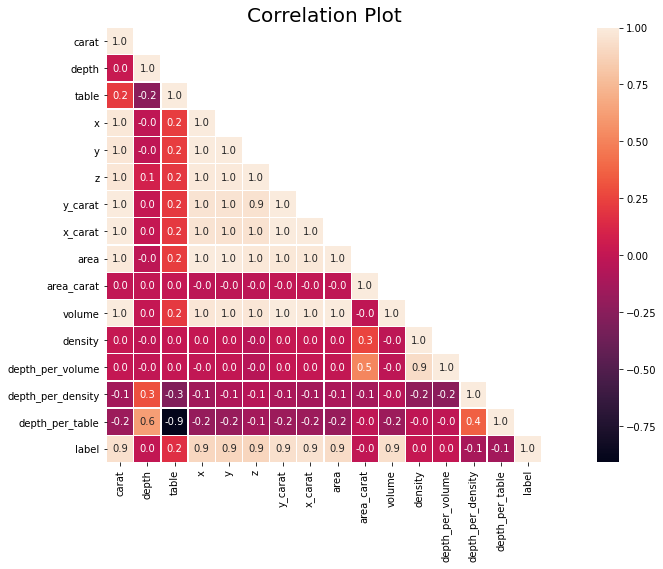

In [12]:
df_train_label = pd.concat([df_train , pd.DataFrame(label)] , axis = 1)
df_train_label = df_train_label.drop(['cut' , 'color' , 'clarity'] , axis = 1)
mask = np.array(df_train_label.corr())
mask[np.tril_indices_from(mask)] = False

fig, ax = plt.subplots() 
fig.set_size_inches(20 , 8)
sns.heatmap(df_train_label.corr(), 
            mask = mask, 
            square = True,
            annot = True, 
            fmt='.1f', 
            linewidth = .3).set_title('Correlation Plot' , fontsize = 20)

<b>Step1 : Identifying features that are highly correlated with label.</b>
* 1. x
* 2. y
* 3. z
* 4. carat
* 5. area
* 6. volume
* 7. x_carat
* 8. y_carat

In [13]:
corr_data = df_train_label.corr()
corr_data = corr_data.drop(['label'] , axis = 1)
corr_data_label = corr_data.loc['label']
features = list(corr_data.loc['label'].index)
target_features = []
for feature in features:
    if corr_data_label.loc[feature] > 0.85:
        target_features.append(feature)
        
print(target_features)        

['carat', 'x', 'y', 'z', 'y_carat', 'x_carat', 'area', 'volume']


<b>Step2 : Performing a groupby operation based on each categorical feature, calculating the median, and standardizing the results.</b>

In [14]:
df_train_label = pd.concat([df_train , pd.DataFrame(label)] , axis = 1)
target_features.append('label')
dict_groupby = {num_f : {obj_f : 0 for obj_f in object_features} for num_f in target_features}
for num_f in target_features:
    for obj_f in object_features:   
        if num_f != 'label':
            temp = df_train_label.groupby(obj_f).apply(lambda x : x[num_f].median()).sort_values()
            temp = (temp - temp.min()) / temp.max()
            dict_groupby[num_f][obj_f] = temp
        else:    
            dict_groupby[num_f][obj_f] = df_train_label.groupby(obj_f).apply(lambda x : x[num_f].median()).sort_values()

<b>Step3 : Summing the results obtained for each categorical feature and sorting them.</b>

In [15]:
dict_groupby_ = {obj_f : [] for obj_f in object_features}  
for obj_f in object_features: 
    for num_f in target_features:
        if num_f != 'label':
            dict_groupby_[obj_f].append(dict_groupby[num_f][obj_f])

cut_groupby_total = pd.concat(dict_groupby_['cut'] , axis = 1).sum(axis = 1).sort_values()
color_groupby_total = pd.concat(dict_groupby_['color'] , axis = 1).sum(axis = 1).sort_values()
clarity_groupby_total = pd.concat(dict_groupby_['clarity'] , axis = 1).sum(axis = 1).sort_values()

<b>Step4 : The sorted result will be the encoding for the categorical feature.</b>

In [16]:
cut = list(cut_groupby_total.index)
color = list(color_groupby_total.index)
clarity = list(clarity_groupby_total.index)
cut_dict = {cut[i] : i for i in range(len(cut))}
color_dict = {color[i] : i for i in range(len(color))}
clarity_dict = {clarity[i] : i for i in range(len(clarity))}
for feature in object_features:    
    # ordinal encoding
    if feature == 'cut':
        df_train['cut'] = df_train['cut'].apply(lambda x:cut_dict[x])
        df_test['cut'] = df_test['cut'].apply(lambda x:cut_dict[x])
    elif feature == 'color':   
        df_train['color'] = df_train['color'].apply(lambda x:color_dict[x])
        df_test['color'] = df_test['color'].apply(lambda x:color_dict[x])
    elif feature == 'clarity':   
        df_train['clarity'] = df_train['clarity'].apply(lambda x:clarity_dict[x]) 
        df_test['clarity'] = df_test['clarity'].apply(lambda x:clarity_dict[x])

# <div style="text-align: center; background-color:#b2182b; font-family:newtimeroman; color: white; padding: 14px; line-height: 1;border-radius:20px">4. Modeling</div>

## <div style="text-align: left; background-color: #a33939; font-family:newtimeroman; color: white; padding: 14px; line-height: 1;border-radius:15px"> 4.1. Base Model </div>

<h4>LGBMRegressor, XGBRegressor and CatBoostRegressor have better performance.</h4>

In [17]:
random_state = 2023
random_state_list = [_ for _ in range(5)] 
def cv_score(model , X , y , fit_params = None , random_state = None ,
             early_stopping = False , early_stopping_rounds = 100 , gb_model = 'xgb' ,
             fit_verbose = False , print_es = True,
             print_scores = True , print_mean_score = True):
    '''
    *A function which computes k-fold CV
    *Model is a pipeline or regressor
    *Outputs CV score for each fold and
     mean CV score across folds using RMSE metric
    *Make sure to set early_stopping = True if desired,
     and set gb_model to be xgb, lgbm, or cb due to
     annoying syntax difference involving best_iteration
    '''
    i = 0
    if early_stopping:
        kf = KFold(n_splits = 5 , shuffle = True , random_state = 42)
        cv_scores = []
        for idx , (train_idx , test_idx) in enumerate(kf.split(X , y)):   
            X_train , X_test = X.iloc[train_idx] , X.iloc[test_idx]
            y_train , y_test = y.iloc[train_idx] , y.iloc[test_idx]
            if gb_model =='cb':
                model.fit(X_train , y_train , eval_set = [(X_test , y_test)],
                          early_stopping_rounds = early_stopping_rounds,
                          verbose = fit_verbose)
                best_it = model.get_best_iteration()
            elif gb_model =='xgb' or gb_model =='lgbm':
                model.fit(X_train , y_train , eval_set = [(X_test , y_test)],
                          eval_metric = 'rmse',
                          early_stopping_rounds = early_stopping_rounds,
                          verbose = fit_verbose)
                if gb_model == 'xgb':
                    best_it = model.best_iteration
                else:
                    best_it = model.best_iteration_
            
            y_pred = model.predict(X_test)
            score = mean_squared_error(y_test , y_pred , squared = False)
            if print_es:
                if gb_model == 'rf' or gb_model == 'ex_tree':
                    pass
                else:
                    print('Fold {} , Score {:.4f} : eval set RMSE score stopped improving after {} iterations.'.format(i + 1 , score , best_it))
            cv_scores.append(score)
            i += 1
            
        mean_score = np.mean(cv_scores)
        if print_scores:
            print('='*90)
            print('RMSE scores for all folds: {}'.format(cv_scores))
        if print_mean_score:
            print('Mean RMSE score across folds: {:.4f}'.format(mean_score))
            print('='*90)
    
    else:
        kf = KFold(n_splits = 5 , random_state = random_state , shuffle = True)
        scores = cross_val_score(model , X , y , fit_params = fit_params , cv = kf , scoring = 'neg_root_mean_squared_error')
        mean_score = np.mean(scores)
        if print_scores:
            print('='*90)
            print('RMSE scores for all folds: {}'.format(scores))
        if print_mean_score:
            print('Mean RMSE score across folds: {:.4f}'.format(mean_score))
            print('='*90)
    return mean_score   
  
    
def cv_score_(model , X , y , random_state = None):
    kf = KFold(n_splits = 5 , shuffle = True , random_state = 42)
    cv_scores = []
    for idx , (train_idx , test_idx) in enumerate(kf.split(X , y)):
        X_train , X_test = X.iloc[train_idx] , X.iloc[test_idx]
        y_train , y_test = y.iloc[train_idx] , y.iloc[test_idx]
        model.fit(X_train , y_train)
        y_pred = model.predict(X_test)
        score = mean_squared_error(y_test , y_pred , squared = False)
        cv_scores.append(score)
    print('RMSE scores for all folds: {}'.format(cv_scores))   
    print('Mean RMSE score across folds: {:.4f}'.format(np.mean(cv_scores) ))
    print('='*90)
    return np.mean(cv_scores) 
   
lgb_model_base = LGBMRegressor(n_estimators = 20000)
xgb_model_base = XGBRegressor(n_estimators = 20000)
cat_model_base = CatBoostRegressor(n_estimators = 20000 , eval_metric = 'RMSE' , bootstrap_type = 'Bernoulli')
rf_model_base = RandomForestRegressor(n_estimators = 100 , max_depth = 30 , n_jobs = -1)
ex_model_base = ExtraTreesRegressor(n_estimators = 100 , max_depth = 30 , n_jobs = -1)

lgb_base_cv_score = cv_score(lgb_model_base , df_train , label , early_stopping = True , gb_model = 'lgbm' , random_state = 42)   
xgb_base_cv_score = cv_score(xgb_model_base , df_train , label , early_stopping = True , gb_model = 'xgb' , random_state = 42)   
cat_base_cv_score = cv_score(cat_model_base , df_train , label , early_stopping_rounds = 500 , early_stopping = True , gb_model = 'cb' , random_state = 42)   
rf_base_cv_score = cv_score_(rf_model_base , df_train , label)   
ex_base_cv_score = cv_score_(ex_model_base , df_train , label)  

Fold 1 , Score 568.1796 : eval set RMSE score stopped improving after 178 iterations.
Fold 2 , Score 574.5882 : eval set RMSE score stopped improving after 181 iterations.
Fold 3 , Score 573.8631 : eval set RMSE score stopped improving after 126 iterations.
Fold 4 , Score 572.8664 : eval set RMSE score stopped improving after 114 iterations.
Fold 5 , Score 582.9673 : eval set RMSE score stopped improving after 136 iterations.
RMSE scores for all folds: [568.1795506593085, 574.588246943547, 573.8630963663052, 572.8663684141045, 582.967299927427]
Mean RMSE score across folds: 574.4929
Fold 1 , Score 574.1369 : eval set RMSE score stopped improving after 37 iterations.
Fold 2 , Score 580.3460 : eval set RMSE score stopped improving after 39 iterations.
Fold 3 , Score 579.9917 : eval set RMSE score stopped improving after 31 iterations.
Fold 4 , Score 578.7612 : eval set RMSE score stopped improving after 38 iterations.
Fold 5 , Score 589.8431 : eval set RMSE score stopped improving after 

## <div style="text-align: left; background-color: #a33939; font-family:newtimeroman; color: white; padding: 14px; line-height: 1;border-radius:15px"> 4.2. Model Fine-Tuning  </div>

## <div style="text-align: left; background-color:#d6604d; font-family:newtimeroman; color: white; padding: 8px; line-height: 1;border-radius:5px"> 4.2.1. LGBMRegressor</div>

In [ ]:
# reg_alpha , lambda_l1 , l1_regularization ; reg_alpha >= 0.0
# reg_lambda , lambda_l2 , l2_regularization ; reg_ambda >= 0.0
# colsample_bytree , sub_feature , feature_fraction ; constraints: 0.0 < colsample_bytree <= 1.0 ; type = double
# subsample , sub_row , bagging_fraction , bagging  ; constraints: 0.0 < subsample <= 1.0 ; type = double
# max_depth , num_leaf , max_leaves , max_leaf , max_leaf_nodes ; <= 0 means no limit ; type = int
# min_child_samples , min_data_per_leaf , min_data, min_data_in_leaf , min_samples_leaf ; constraints: min_data_in_leaf >= 0 ; type = int
# min_child_weight , aliases: min_sum_hessian_per_leaf, min_sum_hessian, min_hessian , min_sum_hessian_in_leaf ; type = double
# cat_smooth ;  constraints: cat_smooth >= 0.0
def objective_lgb(trial , X = df_train , y = label):
    global RANDOM_STATE
    print(RANDOM_STATE)
    param = {'n_estimators'       : 20000 ,
             'metric'             : 'rmse' ,
             'learning_rate'      : trial.suggest_loguniform('learning_rate' , 0.006 , 0.02),
             'reg_alpha'          : trial.suggest_loguniform('reg_alpha' , 1e-9 , 10.0) ,  # L1 regularization
             'reg_lambda'         : trial.suggest_loguniform('reg_lambda' , 1e-9 , 10.0) , # L2 regularization
             'colsample_bytree'   : trial.suggest_categorical('colsample_bytree' , [i/10 for i in range(3 , 11)]) ,  #  deal with over-fitting
             'subsample'          : trial.suggest_categorical('subsample' , [i/10 for i in range(4 , 11)]) ,         #  deal with over-fitting
             'max_depth'          : trial.suggest_int('max_depth' , 5 , 100),
             'num_leaves'         : trial.suggest_int('num_leaves' , 5 , 1000),
             'min_child_samples'  : trial.suggest_int('min_child_samples' , 1 , 300),     #  deal with over-fitting
             'min_child_weight'   : trial.suggest_int('min_child_samples' , 0.01 , 10),   #  deal with over-fitting
             'cat_smooth'         : trial.suggest_int('cat_smooth' , 1 , 100)}   
    
    X_train , X_test , y_train , y_test = train_test_split(X , y , test_size = 0.2 , random_state = RANDOM_STATE) 
    model = LGBMRegressor(**param)
    model.fit(X_train , y_train , eval_set = [(X_test , y_test)] , early_stopping_rounds = 100 , verbose = False)
    preds = model.predict(X_test)
    score = mean_squared_error(y_test , preds , squared = False)
    return score

lgb_params_set = []
for i in range(0 , 3):
    RANDOM_STATE = 42 + i
    study = optuna.create_study(direction = 'minimize')
    study.optimize(objective_lgb , n_trials = 30)
    print('Number of finished trials:{}'.format(len(study.trials)))
    lgb_result = study.trials_dataframe()
    lgb_params = study.best_params 
    lgb_params['metric'] = 'rmse'
    lgb_params['n_estimators'] = 20000  
    lgb_params_set.append(lgb_params)
    print('lgb_{} completed !!'.format(i + 1))

with open('params/best_lgb_params.pkl', 'wb') as f:
    pickle.dump(lgb_params_set , f)
    
    
# def objective_cv_lgb(trial , X = df_train , y = label):
#     param = {'n_estimators'       : 20000 ,
#              'metric'             : 'rmse' ,
#              'learning_rate'      : trial.suggest_loguniform('learning_rate' , 0.006 , 0.02),
#              'reg_alpha'          : trial.suggest_loguniform('reg_alpha' , 1e-9 , 10.0) ,  # L1 regularization
#              'reg_lambda'         : trial.suggest_loguniform('reg_lambda' , 1e-9 , 10.0) , # L2 regularization
#              'colsample_bytree'   : trial.suggest_categorical('colsample_bytree' , [i/10 for i in range(3 , 11)]) ,  #  deal with over-fitting
#              'subsample'          : trial.suggest_categorical('subsample' , [i/10 for i in range(4 , 11)]) ,         #  deal with over-fitting
#              'max_depth'          : trial.suggest_int('max_depth' , 5 , 100),
#              'num_leaves'         : trial.suggest_int('num_leaves' , 5 , 1000),
#              'min_child_samples'  : trial.suggest_int('min_child_samples' , 1 , 300),     #  deal with over-fitting
#              'min_child_weight'   : trial.suggest_int('min_child_samples' , 0.01 , 10),   #  deal with over-fitting
#              'cat_smooth'         : trial.suggest_int('cat_smooth' , 1 , 100)}  
 
#     kf = KFold(n_splits = 5 , shuffle = True , random_state = 42)
#     cv_scores = []
#     for idx , (train_idx , test_idx) in enumerate(kf.split(X , y)):
#         X_train , X_test = X.iloc[train_idx] , X.iloc[test_idx]
#         y_train , y_test = y.iloc[train_idx] , y.iloc[test_idx]
#         model = LGBMRegressor(**param)
#         model.fit(X_train , y_train , eval_set = [(X_test , y_test)] , early_stopping_rounds = 100 , verbose = False)
#         preds = model.predict(X_test)
#         score = mean_squared_error(y_test , preds , squared = False)
#         cv_scores.append(score)
#     return np.mean(cv_scores) 

# study = optuna.create_study(direction = 'minimize')
# study.optimize(objective_cv_lgb , n_trials = 30)
# print('Number of finished trials:{}'.format(len(study.trials)))
# lgb_result = study.trials_dataframe()
# lgb_params = study.best_params 
# lgb_params['metric'] = 'rmse'
# lgb_params['n_estimators'] = 20000      

## <div style="text-align: left; background-color:#d6604d; font-family:newtimeroman; color: white; padding: 8px; line-height: 1;border-radius:5px"> 4.2.2. XGBRegressor</div>

In [ ]:
def objective_xgb(trial , X = df_train , y = label):
    global RANDOM_STATE
    print(RANDOM_STATE)
    param = {'n_estimators'       : 20000  ,
             'eval_metric'        : 'rmse' ,
             'learning_rate'      : trial.suggest_loguniform('learning_rate' , 0.003 , 0.02),
             'lambda'             : trial.suggest_loguniform('lambda' , 1e-9 , 10.0),
             'alpha'              : trial.suggest_loguniform('alpha' , 1e-9 , 10.0),
             'reg_alpha'          : trial.suggest_loguniform('reg_alpha' , 1e-9 , 10.0) ,
             'reg_lambda'         : trial.suggest_loguniform('reg_lambda' , 1e-9 , 10.0) ,
             'colsample_bytree'   : trial.suggest_categorical('colsample_bytree' , [i/10 for i in range(3 , 11)]) ,
             'subsample'          : trial.suggest_categorical('subsample' , [i/10 for i in range(4 , 11)]) ,
             'max_depth'          : trial.suggest_int('max_depth' , 5 , 100),
             'max_leaves'         : trial.suggest_int('max_leaves' , 10 , 1000),
             'min_child_weight'   : trial.suggest_int('min_child_weight', 1 , 300)}
 
    X_train , X_test , y_train , y_test = train_test_split(X , y , test_size = 0.2 , random_state = RANDOM_STATE) 
    model = XGBRegressor(**param) 
    model.fit(X_train , y_train , eval_set = [(X_test , y_test)] , early_stopping_rounds = 100 , verbose = False)
    preds = model.predict(X_test)
    score = mean_squared_error(y_test , preds , squared = False)
    return score

xgb_params_set = []
for i in range(0 , 3):
    RANDOM_STATE = 42 + i
    study = optuna.create_study(direction = 'minimize')
    study.optimize(objective_xgb , n_trials = 30)
    print('Number of finished trials:{}'.format(len(study.trials)))
    xgb_result = study.trials_dataframe()
    xgb_params = study.best_params 
    xgb_params['n_estimators'] = 20000  
    xgb_params['eval_metric'] = 'rmse'
    xgb_params_set.append(xgb_params)
    print('xgb_{} completed !!'.format(i + 1))

with open('params/best_xgb_params.pkl', 'wb') as f:
    pickle.dump(xgb_params_set , f)
    
    
# def objective_cv_xgb(trial , X = df_train , y = label):
#     param = {'n_estimators'       : 20000  ,
#              'eval_metric'        : 'rmse' ,
#              'learning_rate'      : trial.suggest_loguniform('learning_rate' , 0.006 , 0.02),
#              'lambda'             : trial.suggest_loguniform('lambda' , 1e-3 , 10.0),
#              'alpha'              : trial.suggest_loguniform('alpha' , 1e-3 , 10.0),
#              'reg_alpha'          : trial.suggest_loguniform('reg_alpha' , 1e-3 , 10.0) ,
#              'reg_lambda'         : trial.suggest_loguniform('reg_lambda' , 1e-3 , 10.0) ,
#              'colsample_bytree'   : trial.suggest_categorical('colsample_bytree' , [i/10 for i in range(3 , 11)]) ,
#              'subsample'          : trial.suggest_categorical('subsample' , [i/10 for i in range(4 , 11)]) ,
#              'max_depth'          : trial.suggest_int('max_depth' , 10 , 100),
#              'max_leaves'         : trial.suggest_int('max_leaves' , 10 , 1000),
#              'min_child_weight'   : trial.suggest_int('min_child_weight', 1 , 300)}
 
#     kf = KFold(n_splits = 5 , shuffle = True , random_state = 42)
#     cv_scores = []
#     for idx , (train_idx , test_idx) in enumerate(kf.split(X , y)):
#         X_train , X_test = X.iloc[train_idx] , X.iloc[test_idx]
#         y_train , y_test = y.iloc[train_idx] , y.iloc[test_idx]
#         model = XGBRegressor(**param) 
#         model.fit(X_train , y_train , eval_set = [(X_test , y_test)] , early_stopping_rounds = 100 , verbose = False)
#         preds = model.predict(X_test)
#         score = mean_squared_error(y_test , preds , squared = False)
#         cv_scores.append(score)
#     return np.mean(cv_scores) 

# study = optuna.create_study(direction = 'minimize')
# study.optimize(objective_cv_xgb , n_trials = 30)
# print('Number of finished trials:{}'.format(len(study.trials)))
# xgb_result = study.trials_dataframe()
# xgb_params = study.best_params 
# xgb_params['n_estimators'] = 20000  
# xgb_params['eval_metric'] = 'rmse'    

## <div style="text-align: left; background-color:#d6604d; font-family:newtimeroman; color: white; padding: 8px; line-height: 1;border-radius:5px"> 4.2.3. CatBoostRegressor</div>

In [ ]:
# l2_leaf_reg , l2-leaf-regularizer , reg_lambda
# min_data_in_leaf , min_child_samples
def objective_cat(trial , X = df_train , y = label):
    global RANDOM_STATE
    print(RANDOM_STATE)
    param = {'n_estimators'      : 20000 ,
             'loss_function'     : 'RMSE',
             'l2_leaf_reg'       : trial.suggest_loguniform('l2_leaf_reg' , 1e-3 , 10.0),
             'rsm'               : trial.suggest_uniform('rsm' , 0.3 , 1.0),
             'subsample'         : trial.suggest_uniform('subsample' , 0.4 , 1.0),
             'learning_rate'     : trial.suggest_uniform('learning_rate' , 0.006 , 0.018),
             'max_depth'         : trial.suggest_int('max_depth' , 5 , 15),
             'max_bin'           : trial.suggest_int('max_bin' , 200 , 400),
             'min_data_in_leaf'  : trial.suggest_int('min_data_in_leaf' , 1 , 300)}
 
    X_train , X_test , y_train , y_test = train_test_split(X , y , test_size = 0.2 , random_state = RANDOM_STATE) 
    model = CatBoostRegressor(**param)
    model.fit(X_train , y_train , eval_set = [(X_test , y_test)] , early_stopping_rounds = 100 , verbose = False)
    preds = model.predict(X_test)
    score = mean_squared_error(y_test , preds , squared = False)
    return score

cat_params_set = []
for i in range(0 , 3):
    RANDOM_STATE = 42 + i
    study = optuna.create_study(direction = 'minimize')
    study.optimize(objective_cat , n_trials = 30)
    print('Number of finished trials:{}'.format(len(study.trials)))
    cat_results = study.trials_dataframe()
    cat_params = study.best_params 
    cat_params['n_estimators'] = 20000  
    cat_params['loss_function'] = 'RMSE'
    cat_params_set.append(cat_params)
    print('cat_{} completed !!'.format(i + 1))

with open('params/best_cat_params.pkl', 'wb') as f:
    pickle.dump(cat_params_set , f)
    
    
# def objective_cv_cat(trial , X = df_train , y = label):
#     param = {'n_estimators'      : 20000 ,
#              'loss_function'     : 'RMSE',
#              'l2_leaf_reg'       : trial.suggest_loguniform('l2_leaf_reg' , 1e-3 , 10.0),
#              'rsm'               : trial.suggest_uniform('rsm' , 0.3 , 1.0),
#              'subsample'         : trial.suggest_uniform('subsample' , 0.4 , 1.0),
#              'learning_rate'     : trial.suggest_uniform('learning_rate' , 0.006 , 0.018),
#              'max_depth'         : trial.suggest_int('max_depth' , 5 , 15),
#              'max_bin'           : trial.suggest_int('max_bin' , 200 , 400),
#              'min_data_in_leaf'  : trial.suggest_int('min_data_in_leaf' , 1 , 300)}
 
#     kf = KFold(n_splits = 5 , shuffle = True , random_state = 42)
#     cv_scores = []
#     for idx , (train_idx , test_idx) in enumerate(kf.split(X , y)):
#         X_train , X_test = X.iloc[train_idx] , X.iloc[test_idx]
#         y_train , y_test = y.iloc[train_idx] , y.iloc[test_idx]
#         model = CatBoostRegressor(**param)
#         model.fit(X_train , y_train , eval_set = [(X_test , y_test)] , early_stopping_rounds = 100 , verbose = False)
#         preds = model.predict(X_test)
#         score = mean_squared_error(y_test , preds , squared = False)
#         cv_scores.append(score)
#     return np.mean(cv_scores) 

# study = optuna.create_study(direction = 'minimize')
# study.optimize(objective_cv_cat , n_trials = 30)
# print('Number of finished trials:{}'.format(len(study.trials)))
# cat_results = study.trials_dataframe()
# cat_params = study.best_params 
# cat_params['n_estimators'] = 20000  
# cat_params['loss_function' ] = 'RMSE'    

In [ ]:
# def objective_rf(trial , X = df_train , y = label):
#     param = {'bootstrap'          : trial.suggest_categorical('bootstrap' , [True , False]) ,
#              'max_features'       : trial.suggest_categorical('max_features' , ['auto' , 'log2' , 'sqrt']) ,
#              'criterion'          : trial.suggest_categorical('criterion' , ['squared_error' , 'absolute_error' , 'friedman_mse' , 'squared_error']) ,
#              'n_estimators'       : trial.suggest_int('n_estimators' , 50 , 200) ,
#              'max_depth'          : trial.suggest_int('max_depth' , 5 , 100) ,
#              'min_samples_split'  : trial.suggest_int('min_samples_split' , 2 , 20),
#              'min_samples_leaf'   : trial.suggest_int('min_samples_leaf' , 1 , 10)}  
 
#     X_train , X_test , y_train , y_test = train_test_split(X , y , test_size = 0.2 , random_state = 42) 
#     model = RandomForestRegressor(n_jobs = -1 , **param)
#     model.fit(X_train , y_train)
#     preds = model.predict(X_test)
#     score = mean_squared_error(y_test , preds , squared = False)
#     return score

# rf_params_set = []
# for i in range(0 , 3):
#     RANDOM_STATE = 42 + i
#     study = optuna.create_study(direction = 'minimize')
#     study.optimize(objective_rf , n_trials = 30)
#     print('Number of finished trials:{}'.format(len(study.trials)))
#     rf_result = study.trials_dataframe()
#     rf_params = study.best_params
#     rf_params_set.append(rf_params)
#     print('rf_{} completed !!'.format(i + 1))

# with open('best_rf_params.pkl', 'wb') as f:
#     pickle.dump(rf_params_set , f)
    
    
# def objective_cv_rf(trial , X = df_train , y = label):
#     param = {'bootstrap'          : trial.suggest_categorical('bootstrap' , [True, False]) ,
#              'max_features'       : trial.suggest_categorical('max_features' , ['auto' , 'sqrt']) ,
#              'criterion'          : trial.suggest_categorical('criterion' , ['squared_error' , 'absolute_error' , 'friedman_mse' , 'squared_error']) ,
#              'n_estimators'       : trial.suggest_int('n_estimators' , 100 , 1000) ,
#              'max_depth'          : trial.suggest_int('max_depth' , 5 , 100) ,
#              'min_samples_split'  : trial.suggest_int('min_samples_split' , 2 , 20),
#              'min_samples_leaf'   : trial.suggest_int('min_samples_leaf' , 1 , 10)}  
 
#     kf = StratifiedKFold(n_splits = 5 , shuffle = True , random_state = 42)
#     cv_scores = []
#     for idx , (train_idx , test_idx) in enumerate(kf.split(X , y)):
#         X_train , X_test = X.iloc[train_idx] , X.iloc[test_idx]
#         y_train , y_test = y.iloc[train_idx] , y.iloc[test_idx]
#         model = RandomForestRegressor(n_jobs = -1 , **param)
#         model.fit(X_train , y_train)
#         preds = model.predict(X_test)
#         score = mean_squared_error(y_test , preds , squared = False)
#         cv_scores.append(score)
#     return np.mean(cv_scores) 

# study = optuna.create_study(direction = 'minimize')
# study.optimize(objective_cv_rf , n_trials = 30)
# print('Number of finished trials:{}'.format(len(study.trials)))
# rf_result = study.trials_dataframe()
# rf_params = study.best_params    

In [ ]:
# def objective_ex(trial , X = df_train , y = label):
#     param = {'bootstrap'          : trial.suggest_categorical('bootstrap' , [True, False]) ,
#              'max_features'       : trial.suggest_categorical('max_features' , ['auto' , 'log2' , 'sqrt']) ,
#              'criterion'          : trial.suggest_categorical('criterion' , ['squared_error' , 'absolute_error' , 'friedman_mse' , 'squared_error']) ,
#              'n_estimators'       : trial.suggest_int('n_estimators' , 50 , 200) ,
#              'max_depth'          : trial.suggest_int('max_depth' , 5 , 100) ,
#              'min_samples_split'  : trial.suggest_int('min_samples_split' , 2 , 20),
#              'min_samples_leaf'   : trial.suggest_int('min_samples_leaf' , 1 , 10)}  
 
#     X_train , X_test , y_train , y_test = train_test_split(X , y , test_size = 0.2 , random_state = 42) 
#     model = ExtraTreesRegressor(n_jobs = -1 , **param)
#     model.fit(X_train , y_train)
#     preds = model.predict(X_test)
#     rmse = mean_squared_error(y_test , preds , squared = False)
#     return rmse

# ex_params_set = []
# for i in range(0 , 3):
#     RANDOM_STATE = 42 + i
#     study = optuna.create_study(direction = 'minimize')
#     study.optimize(objective_ex , n_trials = 30)
#     print('Number of finished trials:{}'.format(len(study.trials)))
#     ex_result = study.trials_dataframe()
#     ex_params = study.best_params
#     ex_params_set.append(ex_params)
#     print('ex_{} completed !!'.format(i + 1))

# with open('best_ex_params.pkl', 'wb') as f:
#     pickle.dump(ex_params_set , f)
    
    
# def objective_cv_ex(trial , X = df_train , y = label):
#     param = {'bootstrap'          : trial.suggest_categorical('bootstrap' , [True, False]) ,
#              'max_features'       : trial.suggest_categorical('max_features' , ['auto' , 'sqrt']) ,
#              'criterion'          : trial.suggest_categorical('criterion' , ['squared_error' , 'absolute_error' , 'friedman_mse' , 'squared_error']) ,
#              'n_estimators'       : trial.suggest_int('n_estimators' , 100 , 1000) ,
#              'max_depth'          : trial.suggest_int('max_depth' , 5 , 100) ,
#              'min_samples_split'  : trial.suggest_int('min_samples_split' , 2 , 20),
#              'min_samples_leaf'   : trial.suggest_int('min_samples_leaf' , 1 , 10)}  
 
#     kf = StratifiedKFold(n_splits = 5 , shuffle = True , random_state = 42)
#     cv_scores = []
#     for idx , (train_idx , test_idx) in enumerate(kf.split(X , y)):
#         X_train , X_test = X.iloc[train_idx] , X.iloc[test_idx]
#         y_train , y_test = y.iloc[train_idx] , y.iloc[test_idx]
#         model = ExtraTreesRegressor(n_jobs = -1 , **param)
#         model.fit(X_train , y_train)
#         preds = model.predict(X_test)
#         score = mean_squared_error(y_test , preds , squared = False)
#         cv_scores.append(score)
#     return np.mean(cv_scores) 

# study = optuna.create_study(direction = 'minimize')
# study.optimize(objective_cv_ex , n_trials = 30)
# print('Number of finished trials:{}'.format(len(study.trials)))
# ex_result = study.trials_dataframe()
# ex_params = study.best_params        

## <div style="text-align: left; background-color:#d6604d; font-family:newtimeroman; color: white; padding: 8px; line-height: 1;border-radius:5px"> 4.2.4. Collect Best Parameters</div>

In [18]:
with open('params/best_lgb_params.pkl', 'rb') as f:
    lgb_params_set = pickle.load(f)

with open('params/best_xgb_params.pkl', 'rb') as f:
    xgb_params_set = pickle.load(f)    
    
with open('params/best_cat_params.pkl', 'rb') as f:
    cat_params_set = pickle.load(f)

lgb_models = [LGBMRegressor(**lgb_params) for lgb_params in lgb_params_set]
xgb_models = [XGBRegressor(**xgb_params) for xgb_params in xgb_params_set]
cat_models = [CatBoostRegressor(**cat_params) for cat_params in cat_params_set]
models = lgb_models + xgb_models + cat_models

# <div style="text-align: center; background-color:#b2182b; font-family:newtimeroman; color: white; padding: 14px; line-height: 1;border-radius:20px">5. Ensemple Stacking</div>

In [19]:
def stacking_generate_feature(model , model_idx , df_train , label , df_test , mode = 'regression'):
    if mode == 'regression':
        kf = KFold(n_splits = 5 , shuffle = True , random_state = 42)
        first_feature_train , first_feature_test , first_label_train = [] , [] , []
        mean_score = []
        for idx , (train_idx , test_idx) in enumerate(kf.split(df_train , label)):
            X_train , X_test = df_train.iloc[train_idx] , df_train.iloc[test_idx]
            y_train , y_test = label.iloc[train_idx] , label.iloc[test_idx]
            model.fit(X_train , y_train , eval_set = [(X_test , y_test)] , early_stopping_rounds = 100 , verbose = False)
            first_feature_train.append(model.predict(X_test))
            first_label_train.append(np.array(y_test))
            first_feature_test.append(model.predict(df_test))

            score = mean_squared_error(y_test , first_feature_train[-1] , squared = False)
            mean_score.append(score)
        print('Rmse Score from model {} : {}'.format(model_idx , np.mean(mean_score)))  
        return np.hstack(first_feature_train) , np.hstack(first_label_train) , np.vstack(first_feature_test).mean(axis = 0)
    
    else mode == 'classfication':
        kf = StratifiedKFold(n_splits = 5 , shuffle = True , random_state = 42)
        first_feature_train , first_feature_test , first_label_train = [] , [] , []
        mean_auc = []
        for idx , (train_idx , test_idx) in enumerate(kf.split(df_train , label)):
            X_train , X_test = df_train.iloc[train_idx] , df_train.iloc[test_idx]
            y_train , y_test = label.iloc[train_idx] , label.iloc[test_idx]
            model.fit(X_train , y_train)
            first_feature_train.append(model.predict_proba(X_test))
            first_label_train.append(np.array(y_test))
            if idx == 0:
                first_feature_test = model.predict_proba(df_test)
            else:
                first_feature_test += model.predict_proba(df_test) 

            AUC = roc_auc_score(y_test , first_feature_train[-1][: , 1])
            mean_auc.append(AUC)
        print('AUC Score from model: {}'.format(np.mean(mean_auc)))  
        return np.vstack(first_feature_train) , np.hstack(first_label_train) , first_feature_test / (idx + 1)

        
first_feature_train_list , first_feature_test_list = [] , []
for model_idx , model in enumerate(models):
    first_feature_train , first_label_train , first_feature_test = stacking_generate_feature(model , model_idx , df_train , label , df_test , mode = 'regression')
    first_feature_train_list.append(first_feature_train)
    first_feature_test_list.append(first_feature_test)
    
first_feature_train_list = np.vstack(first_feature_train_list).T
first_feature_train_list = pd.DataFrame(first_feature_train_list)
first_label_train = pd.DataFrame(first_label_train)

first_feature_test_list = np.vstack(first_feature_test_list).T
first_feature_test_list = pd.DataFrame(first_feature_test_list)

Rmse Score from model 0 : 572.6162971888949
Rmse Score from model 1 : 570.5142810679806
Rmse Score from model 2 : 571.8588580594717
Rmse Score from model 3 : 569.3679076199794
Rmse Score from model 4 : 570.2151417931688
Rmse Score from model 5 : 571.898167916121
Rmse Score from model 6 : 569.9981153250643
Rmse Score from model 7 : 570.3737004547982
Rmse Score from model 8 : 570.3600430896645


In [20]:
def objective_cv_Ridge(trial , X = first_feature_train_list , y = first_label_train):
    param = {'alpha' : trial.suggest_uniform('alpha' , 1e-9 , 1e-3)}
 
    kf = KFold(n_splits = 5 , shuffle = True , random_state = 42)
    cv_scores = []
    for idx , (train_idx , test_idx) in enumerate(kf.split(X , y)):
        X_train , X_test = X.iloc[train_idx] , X.iloc[test_idx]
        y_train , y_test = y.iloc[train_idx] , y.iloc[test_idx]
        model = Ridge(**param)
        model.fit(X_train , y_train)
        preds = model.predict(X_test)
        rmse = mean_squared_error(y_test , preds , squared = False)
        cv_scores.append(rmse)
    return np.mean(cv_scores) 

study = optuna.create_study(direction = 'minimize')
study.optimize(objective_cv_Ridge , n_trials = 100)
print('Number of finished trials:{}'.format(len(study.trials)))
Ridget_results = study.trials_dataframe()
Ridge_params = study.best_params 

second_model = Ridge(**Ridge_params)
second_model.fit(first_feature_train_list , first_label_train)
preds = second_model.predict(first_feature_test_list)

submission_df = pd.read_csv('./sample_submission.csv' , index_col = 'id')
submission_df['price'] = preds
submission_df.to_csv('Ensemble_submission_optuna.csv')

[I 2023-06-03 00:23:27,142] A new study created in memory with name: no-name-7c9b5439-117c-4b2e-bccc-ffbed760c425
[I 2023-06-03 00:23:27,439] Trial 0 finished with value: 567.3215951026224 and parameters: {'alpha': 0.0006791442345280386}. Best is trial 0 with value: 567.3215951026224.
[I 2023-06-03 00:23:27,732] Trial 1 finished with value: 567.3215951026224 and parameters: {'alpha': 0.0006064278210346407}. Best is trial 0 with value: 567.3215951026224.
[I 2023-06-03 00:23:28,019] Trial 2 finished with value: 567.321595102622 and parameters: {'alpha': 0.00013349356503099808}. Best is trial 2 with value: 567.321595102622.
[I 2023-06-03 00:23:28,302] Trial 3 finished with value: 567.3215951026224 and parameters: {'alpha': 0.0005514400885534528}. Best is trial 2 with value: 567.321595102622.
[I 2023-06-03 00:23:28,593] Trial 4 finished with value: 567.3215951026216 and parameters: {'alpha': 0.000805441705239881}. Best is trial 4 with value: 567.3215951026216.
[I 2023-06-03 00:23:28,876] T

[I 2023-06-03 00:23:40,201] Trial 44 finished with value: 567.3215951026216 and parameters: {'alpha': 0.0008614210613235094}. Best is trial 4 with value: 567.3215951026216.
[I 2023-06-03 00:23:40,497] Trial 45 finished with value: 567.3215951026216 and parameters: {'alpha': 0.0009412165892467018}. Best is trial 4 with value: 567.3215951026216.
[I 2023-06-03 00:23:40,782] Trial 46 finished with value: 567.3215951026224 and parameters: {'alpha': 0.000720562024126572}. Best is trial 4 with value: 567.3215951026216.
[I 2023-06-03 00:23:41,078] Trial 47 finished with value: 567.3215951026216 and parameters: {'alpha': 0.0008792532914541428}. Best is trial 4 with value: 567.3215951026216.
[I 2023-06-03 00:23:41,374] Trial 48 finished with value: 567.3215951026216 and parameters: {'alpha': 0.0008154971451320398}. Best is trial 4 with value: 567.3215951026216.
[I 2023-06-03 00:23:41,660] Trial 49 finished with value: 567.3215951026216 and parameters: {'alpha': 0.0009494488322166513}. Best is tr

[I 2023-06-03 00:23:53,301] Trial 89 finished with value: 567.3215951026216 and parameters: {'alpha': 0.000995694825182658}. Best is trial 4 with value: 567.3215951026216.
[I 2023-06-03 00:23:53,595] Trial 90 finished with value: 567.3215951026216 and parameters: {'alpha': 0.0009248656544908373}. Best is trial 4 with value: 567.3215951026216.
[I 2023-06-03 00:23:53,886] Trial 91 finished with value: 567.3215951026216 and parameters: {'alpha': 0.0009633407888156273}. Best is trial 4 with value: 567.3215951026216.
[I 2023-06-03 00:23:54,176] Trial 92 finished with value: 567.3215951026216 and parameters: {'alpha': 0.0008825177211763416}. Best is trial 4 with value: 567.3215951026216.
[I 2023-06-03 00:23:54,470] Trial 93 finished with value: 567.3215951026216 and parameters: {'alpha': 0.0009094070490236841}. Best is trial 4 with value: 567.3215951026216.
[I 2023-06-03 00:23:54,770] Trial 94 finished with value: 567.3215951026216 and parameters: {'alpha': 0.0009981475507746724}. Best is tr

Number of finished trials:100
